# Data

Read dataset

In [1]:
import pandas as pd

dataset = pd.read_csv('data/feature-selection-dataset.csv', header=None)
dataset.head()

,0,1,2,3,4,5,6,7,8,9,...,92,93,94,95,96,97,98,99,100,101
0,8.0,1.0,0.19,0.33,0.02,0.90,0.12,0.17,0.34,0.47,...,0.12,0.42,0.50,0.51,0.64,0.12,0.26,0.20,0.32,0.20
1,53.0,1.0,0.00,0.16,0.12,0.74,0.45,0.07,0.26,0.59,...,0.21,0.50,0.34,0.60,0.52,0.02,0.12,0.45,0.00,0.67
2,24.0,1.0,0.00,0.42,0.49,0.56,0.17,0.04,0.39,0.47,...,0.14,0.49,0.54,0.67,0.56,0.01,0.21,0.02,0.00,0.43
3,34.0,1.0,0.04,0.77,1.00,0.08,0.12,0.10,0.51,0.50,...,0.19,0.30,0.73,0.64,0.65,0.02,0.39,0.28,0.00,0.12
4,42.0,1.0,0.01,0.55,0.02,0.95,0.09,0.05,0.38,0.38,...,0.11,0.72,0.64,0.61,0.53,0.04,0.09,0.02,0.00,0.03


Now, split dataset into data (features) and targets

In [2]:
data = dataset.drop([101], axis=1)
targets = dataset[[101]]

print('\nData')
print(data.head())

print('\nTargets')
print(targets.head())


Data
    0    1     2     3     4     5     6     7     8     9    ...  91    92   \
0   8.0  1.0  0.19  0.33  0.02  0.90  0.12  0.17  0.34  0.47  ...  0.0  0.12   
1  53.0  1.0  0.00  0.16  0.12  0.74  0.45  0.07  0.26  0.59  ...  0.0  0.21   
2  24.0  1.0  0.00  0.42  0.49  0.56  0.17  0.04  0.39  0.47  ...  0.0  0.14   
3  34.0  1.0  0.04  0.77  1.00  0.08  0.12  0.10  0.51  0.50  ...  0.0  0.19   
4  42.0  1.0  0.01  0.55  0.02  0.95  0.09  0.05  0.38  0.38  ...  0.0  0.11   

    93    94    95    96    97    98    99    100  
0  0.42  0.50  0.51  0.64  0.12  0.26  0.20  0.32  
1  0.50  0.34  0.60  0.52  0.02  0.12  0.45  0.00  
2  0.49  0.54  0.67  0.56  0.01  0.21  0.02  0.00  
3  0.30  0.73  0.64  0.65  0.02  0.39  0.28  0.00  
4  0.72  0.64  0.61  0.53  0.04  0.09  0.02  0.00  

[5 rows x 101 columns]

Targets
    101
0  0.20
1  0.67
2  0.43
3  0.12
4  0.03


# Select features

In [20]:
from GA.algorithm import run_ga

Parameters

In [ ]:
population_size = 50
generations = 800  # use 10 for artificial task. For real task, 200 is sufficient to get RMSE less than 0.125, set to 300 - 600 for RMSE less than 0.124
crossover_rate = 0.1 # hva skal denne brukes til?
mutation_rate = 0.1

Artificial task:

hei
Running Ga 



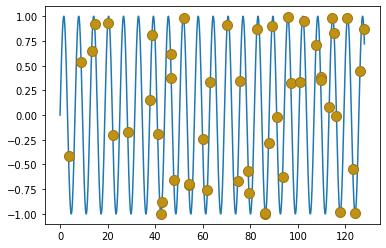

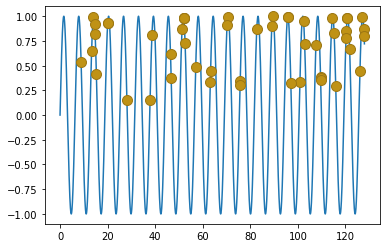

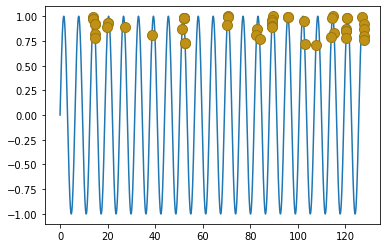

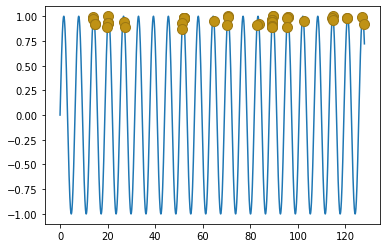

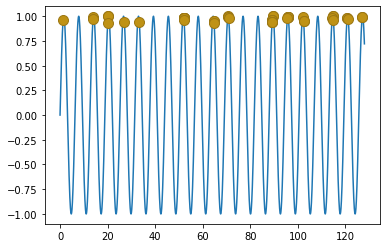

...

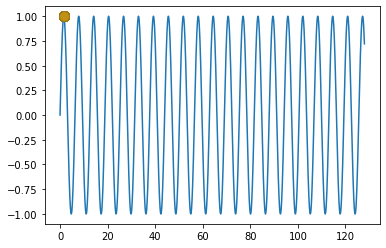

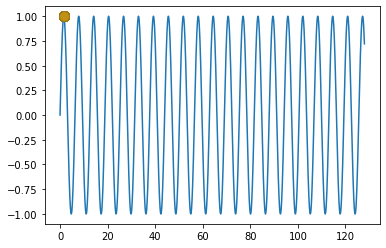

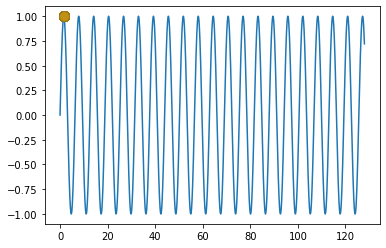

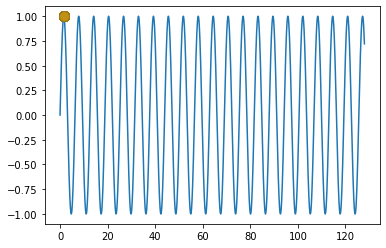

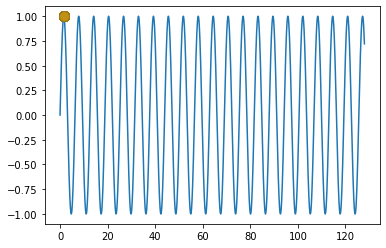

In [ ]:
from metrics.lin_reg import get_fitness
from GA.algorithm import run_ga
from math import sin
from visualizers.plotters import plot_population_fitness
import numpy as np

def visualize_fitness(population, generation):
    plot_population_fitness(population, [0, 128], additional_functions=[np.sin])

# return sin fitness, positive fitness (fitness shifted to positive interval) and phenotype value
def fitness_function(bitstring):
    # get real value of bitstring and scale to fit interval of [0, 128]
    scaling_factor = 2**(-94)
    value = int(bitstring, base=2) * scaling_factor
    fitness = sin(value)
    return fitness, fitness + 1, value
    

print('Running Ga \n')

run_ga(population_size, generations, mutation_rate, crossover_rate, fitness_function, epoch_callback=visualize_fitness)


Real task

In [9]:
from metrics.lin_reg import get_fitness, get_columns
from GA.utils import get_avg_fitness

def visualize_fitness(population, generation):
    print('Generation ', str(generation + 1) ,' | Population fitness ==>  ', get_avg_fitness(population))


def fitness_function(bitstring):
    columns = get_columns(data, bitstring)
    rmse = get_fitness(columns, targets)
    
    # since we want lower rmse to be better, 
    # use e^-rmse as fitness function to make life easier,
    # as the exponential function is almost linear on the interval [0, 0.5], which is where will be most of the time hopefully
    positive_fitness = 1 / ((rmse**4) * 100)
    return rmse, positive_fitness, None


print('RMSE without GA: ', get_fitness(data, targets))

print('Running GA \n')

run_ga(population_size, generations, mutation_rate, crossover_rate, fitness_function, verbose=1, epoch_callback=visualize_fitness)



hei
RMSE without GA:  0.13185533117254247
Running GA 



NameError: name 'population_size' is not defined